In [1]:
import os
import warnings
import pandas as pd
import numpy as np
import re
import glob

from matplotlib import pyplot as plt
from rolestereotype import RoleStereotype as rs

warnings.filterwarnings('ignore')
import seaborn as sns

from matplotlib import rcParams
rcParams.update({'figure.autolayout': True})

sns.set()
sns.set_style(style='white')
%matplotlib inline

In [2]:
df_mobile = pd.read_csv('../../results/csv/mobile_ds_rs.csv')
df_desktop = pd.read_csv('../../results/csv/desktop_ds_rs.csv')

In [3]:
print(f'Mobile: {df_mobile.shape[0]}, Desktop: {df_desktop.shape[0]}')

Mobile: 1793, Desktop: 2465


In [4]:
alldf = pd.concat([df_mobile,df_desktop])

In [5]:
alldf.drop(columns=['Unnamed: 0', 'Project_y'], inplace=True)
alldf.rename(columns={'Project_x': 'Project'}, inplace=True)
alldf.head()

,FullClassPath,Project,SpeculativeGenerality,BaseClassKnowsDerivedClass,MessageChains,LongParameterList,SpaghettiCode,BaseClassShouldBeAbstract,LongMethod,ClassDataShouldBePrivate,...,isInterface,isInnerClass,isClass,isEnum,classPublicity,numPublicMethods,numPrivateMethods,numProtectedMethods,isAbstract,label
0,com.jakewharton.telecine.BugsnagTree,Telecine-v1.6.2,0,0,0,1,0,0,0,0,...,False,False,True,False,default,0,0,0,False,Service Provider
1,com.jakewharton.telecine.CaptureHelper,Telecine-v1.6.2,0,0,0,1,0,0,0,0,...,False,False,True,False,default,0,0,0,False,Service Provider
2,com.jakewharton.telecine.CheatSheet,Telecine-v1.6.2,0,0,0,0,0,0,1,0,...,False,False,True,False,default,0,0,0,False,Service Provider
3,com.jakewharton.telecine.DeleteRecordingBroad...,Telecine-v1.6.2,0,0,0,0,0,0,0,0,...,False,False,True,False,public,0,0,0,False,Service Provider
4,com.jakewharton.telecine.RecordingSession,Telecine-v1.6.2,0,0,0,1,0,0,0,0,...,False,False,True,False,default,0,0,0,False,Interfacer


In [6]:
# all dataset: combined mobile and desktop dataset
# alldf.to_csv('../../results/csv/all.csv')

In [7]:
ds = "SpeculativeGenerality,BaseClassKnowsDerivedClass,MessageChains,LongParameterList,SpaghettiCode,BaseClassShouldBeAbstract,LongMethod,ClassDataShouldBePrivate,TraditionBreaker,ManyFieldAttributesButNotComplex,RefusedParentBequest,SwissArmyKnife,Blob,AntiSingleton,ComplexClass,LargeClass,FunctionalDecomposition,LazyClass".split(",")
len(ds)

18

In [8]:
col = ds.append('label')
temp_df = alldf.groupby('label').sum()
temp_df = temp_df.reindex(['Coordinator', 'Structurer', 'Controller', 'Information Holder', 'Interfacer', 'Service Provider'])
temp_df.reset_index(inplace=True)

In [9]:
ds = ds[0:-1]

In [10]:
# 1. Scatter plot == 

def multi(n): 
    return n
fig, ax = plt.subplots(figsize=(10,8), dpi=1200)

# ensure color are unique 
color_dict = {
    'SpeculativeGenerality': '#5d4037', 
    'BaseClassKnowsDerivedClass' : '#006064', 
    'MessageChains': '#7b1fa2', 
    'LongParameterList': '#512da8',
    'SpaghettiCode' : '#666f9f', 
    'BaseClassShouldBeAbstract' : '#1976d2',
    'LongMethod' : '#d32f2f', 
    'ClassDataShouldBePrivate': '#388e3c', 
    'TraditionBreaker': '#c2185b', 
    'ManyFieldAttributesButNotComplex': '#3e2723',
    'RefusedParentBequest' : '#00796b', 
    'SwissArmyKnife' : '#9e9e9e',
    'Blob' : '#455a64', 
    'AntiSingleton' : '#b3e5fc', 
    'ComplexClass' : '#afb42b', 
    'LargeClass':'#fbe9e7',
    'FunctionalDecomposition' : '#ffeb3b',
    'LazyClass': '#ffa000'
}

for antipattern in ds:
    
    siz = temp_df[antipattern]
    si = map(multi, siz) 
    ax.scatter(temp_df['label'],
               temp_df[antipattern], 
               s=list(si), label=antipattern, c=color_dict[antipattern])
ax.set_ylabel('Design Smell Count')
ax.set_xlabel('Role Stereotypes')
plt.xticks(rotation=0)
lgnd = ax.legend(fancybox=True, framealpha=0.4, ncol=1, bbox_to_anchor=[1, 0.9])
## setting equal legend marker size
for i in range(0, 18):
    lgnd.legendHandles[i]._sizes = [60]
#plt.savefig('../../results/img/bubble_plot.eps', format='eps')
plt.show()

In [11]:
col = [ i for i in ds ]
col.append('label')
temp_df[col]

,SpeculativeGenerality,BaseClassKnowsDerivedClass,MessageChains,LongParameterList,SpaghettiCode,BaseClassShouldBeAbstract,LongMethod,ClassDataShouldBePrivate,TraditionBreaker,ManyFieldAttributesButNotComplex,RefusedParentBequest,SwissArmyKnife,Blob,AntiSingleton,ComplexClass,LargeClass,FunctionalDecomposition,LazyClass,label
0,2,0,0,9,0,0,0,0,0,0,0,0,7,0,18,0,0,0,Coordinator
1,0,0,1,12,0,6,23,3,0,0,0,1,17,4,52,0,0,0,Structurer
2,0,0,0,30,8,3,20,15,0,0,0,0,46,7,73,0,0,2,Controller
3,10,0,0,188,0,39,172,144,0,28,88,2,142,45,236,2,0,224,Information Holder
4,0,0,2,188,28,18,629,89,0,3,8,0,23,49,851,0,0,34,Interfacer
5,28,0,1,568,32,97,1298,138,0,0,140,6,49,101,888,0,0,624,Service Provider


In [12]:
rstr = [str(r) for r in rs]

In [13]:
pie_data = {}
for r in rstr:
    pie_data[r] = temp_df[col].groupby('label').sum().T[r].sum()

pie_data

{'Controller': 204,
 'Coordinator': 36,
 'Information Holder': 1320,
 'Interfacer': 1922,
 'Service Provider': 3970,
 'Structurer': 119}

In [40]:
# 2. pie chart
labels = pie_data.keys()
sizes = list(pie_data.values())
#colors = ['Orange', 'yellowgreen', 'lightcoral', 'lightskyblue', 'teal', 'lightgray']
colors = [rs.CONTROLLER.value[0], rs.COORDINATOR.value[0],
          rs.INFORMATION_HOLDER.value[0], rs.INTERFACER.value[0],
          rs.SERVICE_PROVIDER.value[0], rs.STRUCTURER.value[0]]
explode = (0, 0, 0, 0, 0.02, 0)  # explode 1st slice

fig, ax = plt.subplots(figsize=(10,8), dpi=1200)
# Plot
plt.pie(sizes, 
        explode=explode,
        labels=labels, 
        colors=colors,
        autopct='%1.1f%%',
        startangle=200,textprops={'fontsize': 18})
plt.axis('equal')
plt.savefig('../../results/img/piechart_plot.eps', format='eps')
plt.show()

In [35]:
# stacked bar plot
fig=plt.figure(dpi=1200)
temp_df[col].set_index('label').plot(kind='bar', 
                                     stacked=True, 
                                     figsize=(10,6),
                                     color=color_dict.values(),
                                     ax = plt.gca(),
                                     xlabel='Role Stereotypes',
                                     ylabel='Design Smell Count').legend(bbox_to_anchor=(1, 1.01))
#plt.savefig('../../results/img/stackedbar_plot.eps', format='eps')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [16]:
# 4. Plot heatmap design smells
# Using Spearman Correlation
cmap = sns.diverging_palette(220, 10, as_cmap=True)
ax=plt.figure(figsize=(8,6), dpi=1200)
cor = alldf[col].corr(method='spearman')
ax=sns.heatmap(cor, annot=True, fmt=".1f", annot_kws={"size":6},
               cmap=cmap, cbar_kws={'label':"Spearman correlation coefficient"})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='left')
ax.xaxis.tick_top()
ax.yaxis.tick_left()
# plt.savefig('../../results/img/heapmap_ds_all.eps', format='eps')
plt.show()

In [17]:
# 5. Plot heatmap for rolestereotype and design smell
coll = temp_df[col].set_index('label').T


In [18]:
# Using Spearman Correlation
cmap = sns.diverging_palette(220, 10, as_cmap=True)
ax=plt.figure(figsize=(8,6), dpi=1200)
cor = coll.corr(method='spearman')
ax=sns.heatmap(cor, annot=True, fmt=".1f", annot_kws={"size":6},
               cmap=cmap, cbar_kws={'label':"Spearman correlation coefficient"})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='left')
ax.xaxis.tick_top()
ax.yaxis.tick_left()
ax.set_ylabel(None)
ax.set_xlabel(None)
# plt.savefig('../../results/img/heapmap_rs.eps', format='eps')
plt.show()

In [19]:
mobile = {"Controller":  26,  "Coordinator":  20,  "Information Holder": 258,  "Interfacer": 560,  "Service Provider": 907,  "Structurer":  22}
desktop = {"Controller":  46,  "Coordinator":   5,  "Information Holder": 473,  "Interfacer": 441,  "Service Provider":1461,  "Structurer":  39}

bar_chart = pd.DataFrame(data=[mobile, desktop])
bar_chart=bar_chart.T.reset_index()
bar_chart.rename(columns={"index": "role", 0: "Mobile", 1: "Desktop"}, inplace=True)
bar_chart

,role,Mobile,Desktop
0,Controller,26,46
1,Coordinator,20,5
2,Information Holder,258,473
3,Interfacer,560,441
4,Service Provider,907,1461
5,Structurer,22,39


In [20]:
bar_chart['Mobile(%)'] = [
    (bar_chart.iloc[0, 1] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[1, 1] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[2, 1] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[3, 1] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[4, 1] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[5, 1] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2)
]
bar_chart['Desktop(%)'] = [
    (bar_chart.iloc[0, 2] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[1, 2] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[2, 2] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[3, 2] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[4, 2] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2),
    (bar_chart.iloc[5, 2] / (bar_chart['Mobile'].sum() + bar_chart['Desktop'].sum()) * 100).round(2)
]
bar_chart = bar_chart.reindex([1, 5, 0, 2, 3,4])
bar_chart

,role,Mobile,Desktop,Mobile(%),Desktop(%)
1,Coordinator,20,5,0.47,0.12
5,Structurer,22,39,0.52,0.92
0,Controller,26,46,0.61,1.08
2,Information Holder,258,473,6.06,11.11
3,Interfacer,560,441,13.15,10.36
4,Service Provider,907,1461,21.30,34.31


In [36]:
labels = bar_chart['role']
role_stereo = bar_chart['Mobile(%)'].round(1)
design_class = bar_chart['Desktop(%)'].round(1)

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots(figsize=(10,6), dpi=1200)
rects1 = ax.bar(x - width/2, role_stereo, width, label='Mobile Application', color=rs.SERVICE_PROVIDER.value[0])
rects2 = ax.bar(x + width/2, design_class, width, label='Desktop Application', color=rs.INTERFACER.value[0])

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('Percentage')
ax.set_xlabel('Role stereotypes')
#ax.set_title('Percentage of Design Smells in Mobile vs Desktop Application in Each Role-Stereotype')
ax.set_xticks(x)
ax.set_xticklabels(labels)
ax.legend()


def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax.annotate('{}%'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')


autolabel(rects1)
autolabel(rects2)

fig.tight_layout()
# plt.savefig('../../results/img/barchart_mobile_desktop.eps', format='eps')
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [22]:
# dendogram:

from scipy.cluster.hierarchy import dendrogram, linkage
 # mobile

mobile_dendo = df_mobile[col]
mobile_dendo = mobile_dendo.groupby('label').sum().T.reset_index().rename(columns={'index':'ds'})
mobile_dendo
# single linkage
single_link = linkage(
    y      = mobile_dendo.drop(['ds'], axis = 1), # exclude State column
    method = 'single')

plt.figure(figsize=(10,6), dpi=1200)
# generate dendrogram using the single linkage above
dendrogram(Z               = single_link,
           labels          = mobile_dendo.ds.tolist(),
           color_threshold = 10,
           leaf_rotation=90,
           orientation="top")
# plt.savefig('../../results/img/dendogram_mobile_ds.eps', format='eps')
plt.show()

In [23]:
desktop_dendo = df_desktop[col]
desktop_dendo = desktop_dendo.groupby('label').sum().T.reset_index().rename(columns={'index':'ds'})
desktop_dendo
# single linkage
single_link = linkage(
    y      = desktop_dendo.drop(['ds'], axis = 1), # exclude State column
    method = 'single')

plt.figure(figsize=(10,6), dpi=1200)
# generate dendrogram using the single linkage above
dendrogram(Z               = single_link,
           labels          = desktop_dendo.ds.tolist(),
           color_threshold = 120,
           leaf_rotation=90,
           orientation="top")
# plt.savefig('../../results/img/dendogram_desktop_ds.eps', format='eps')
plt.show()

In [24]:
# Welch's two sample t-test
from scipy.stats import ttest_ind 
t, p = ttest_ind(bar_chart['Mobile(%)'], bar_chart['Desktop(%)'], equal_var = False)
print("welch's test: ", t.round(3), ", pvalue: ", p.round(3))

welch's test:  -0.413 , pvalue:  0.69


In [25]:
rs_dendo = desktop_dendo.T.reset_index().drop(0, axis=0)

In [26]:
# single linkage
single_link = linkage(
    y      = rs_dendo.drop(['label'], axis = 1), # exclude State column
    method = 'single')

plt.figure(figsize=(10,6), dpi=1200)
# generate dendrogram using the single linkage above
dendrogram(Z               = single_link,
           labels          = rs_dendo.label.tolist(),
           color_threshold = 120,
           leaf_rotation=90,
           orientation="top")
# plt.savefig('../../results/img/dendogram_desktop_rs.eps', format='eps')
plt.show()

In [27]:
rs_dendo = mobile_dendo.T.reset_index().drop(0, axis=0)
# single linkage
single_link = linkage(
    y      = rs_dendo.drop(['label'], axis = 1), # exclude State column
    method = 'single')

plt.figure(figsize=(10,9), dpi=1200)
# generate dendrogram using the single linkage above
dendrogram(Z               = single_link,
           labels          = rs_dendo.label.tolist(),
           color_threshold = 120,
           leaf_rotation=90,
           orientation="top")
# plt.savefig('../../results/img/dendogram_mobile_rs.eps', format='eps')  
plt.show()

In [28]:
# Association rule mining
from mlxtend.frequent_patterns import apriori, association_rules

def data_prep(data):
    # read data
    # df = pd.read_csv(data)
    # df = df.iloc[:, 3:21]

    # perform one-hot encoding on "label"
    df_ = pd.get_dummies(data, prefix='_')
    return df_


def rules_mining(df):

    # looking at the association of role-stereotypes with design smells
    # build the model
    # you can adjust the parameters accordingly
    assoc = apriori(df, min_support=0.5, use_colnames=True)
    # collecting the inferred rules in a dataframe
    rules = association_rules(assoc, metric="lift")
    rules = rules.sort_values(
        ['confidence', 'conviction'], ascending=[False, False])
    print(rules)

def reduce_to_binary(qty) : 
    if qty >= 1 :
        return 1
    if qty <= 0 :
        return 0

pdf = data_prep(alldf[col])
_pdf = pdf.applymap(reduce_to_binary)

# rules_mining(_pdf)
_pdf.head()

,SpeculativeGenerality,BaseClassKnowsDerivedClass,MessageChains,LongParameterList,SpaghettiCode,BaseClassShouldBeAbstract,LongMethod,ClassDataShouldBePrivate,TraditionBreaker,ManyFieldAttributesButNotComplex,...,ComplexClass,LargeClass,FunctionalDecomposition,LazyClass,__Controller,__Coordinator,__Information Holder,__Interfacer,__Service Provider,__Structurer
0,0,0,0,1,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,1,0
1,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,1,0
4,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [29]:
metrics = "AntiSingleton,BaseClassKnowsDerivedClass,BaseClassShouldBeAbstract,Blob,ClassDataShouldBePrivate,ComplexClass,FunctionalDecomposition,LargeClass,LazyClass,LongMethod,LongParameterList,ManyFieldAttributesButNotComplex,MessageChains,RefusedParentBequest,SpaghettiCode,SpeculativeGenerality,SwissArmyKnife,TraditionBreaker".split(",")
len(metrics)

18

In [30]:
metrics_def = {
    "AntiSingleton":"A class that provides mutable class variables, which consequently could be used as global variables.",
    "BaseClassKnowsDerivedClass": "A class that has many subclasses without being abstract.",
    "BaseClassShouldBeAbstract": "A class that has many subclasses without being abstract.",
    "Blob": "A large controller class that depends on data stored in surrounding data classes. A large class declares many fields and methods with a low cohesion.",
    "ClassDataShouldBePrivate": "A class exposing its fields, violating the principle of data hiding.",
    "ComplexClass" : "A class having at least one method having a high cyclomatic complexity.",
    "FunctionalDecomposition": "A main class with a procedural name in which inheritance and polymorphism are scarcely used.",
		"LargeClass": "A class that has grown too large in term of Lines of Code.",
    "LazyClass": "A class having very small dimension, few methods and low complexity.",
		"LongMethod": "A method that is unduly long in terms of lines of code.",
    "LongParameterList": "A method having a long list of parameters, some of which avoidable.",
    "ManyFieldAttributesButNotComplex": "A class that declares many attributes but which is not complex and, hence, more likely to be some kind of data class holding values without providing behaviour.",
    "MessageChains": "A long chain of method invocations performed to implement a class functionality.", 
    "RefusedParentBequest": "A class redefining most of the inherited methods, thus signaling a wrong hierarchy.",
    "SpaghettiCode": "A class implementing complex methods interacting between them, with no parameters, using global variables.",
    "SpeculativeGenerality": "A class declared as abstract having very few children classes using its methods.",
    "SwissArmyKnife": "A complex class that offers a high number of services, for example, a complex class implementing a high number of interfaces.",
    "TraditionBreaker": "A class that inherits from a large parent class but that provides little behaviour and without subclasses."
  }

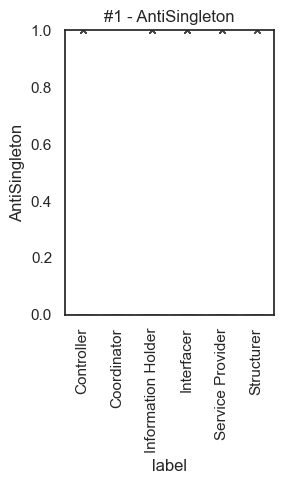

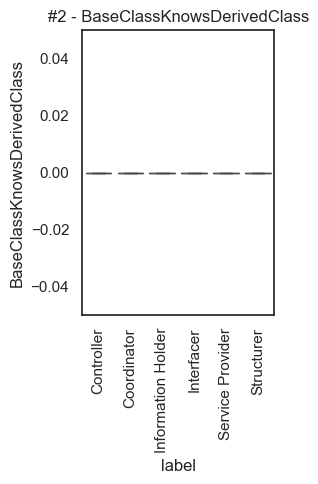

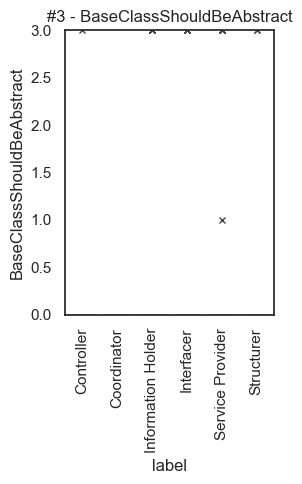

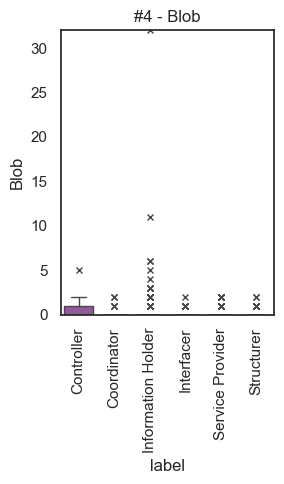

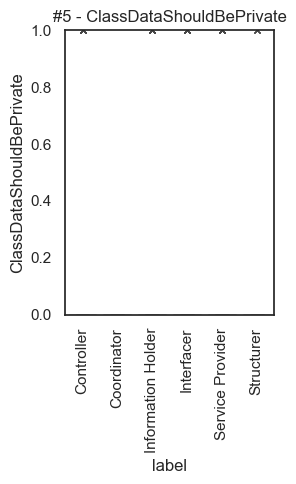

...

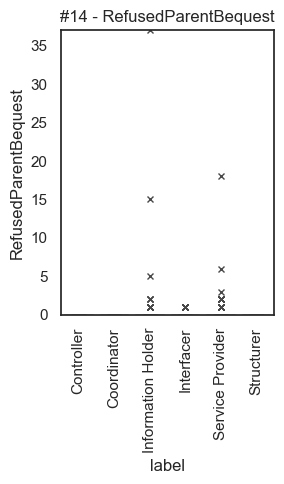

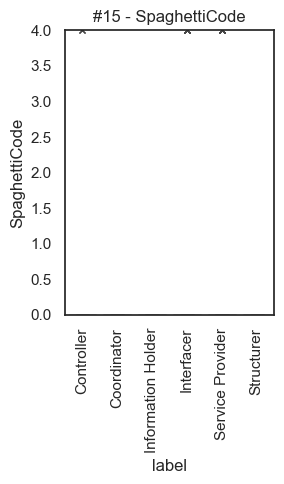

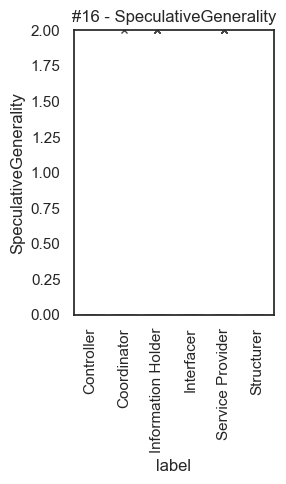

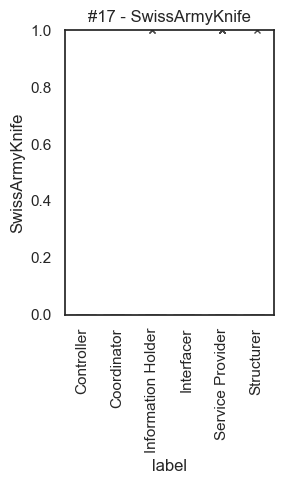

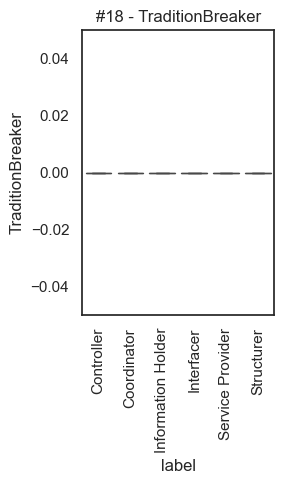

In [31]:
i = 0
for m in metrics:
    plt.figure(i, figsize=(3,5))

    g = sns.boxplot(x='label', y=m,
        palette=rs.dpalette(),
        order=rstr,
        linewidth=1, fliersize=5,
        flierprops={"marker": "x"},
        data=alldf)
    mn = alldf[m].min() 
    mx = alldf[m].max()
    g.set(ylim=(mn,mx), title=f'#{i+1} - {m}')
    # g.set(title=f'#{i+1} - {m}')

    plt.xticks(rotation = 90)
    plt.show()
    i += 1